# **StyleGAN** - **Style**-Based Generator Architecture for **GAN**s)

Paper: [A Style-Based Generator Architecture for Generative Adversarial Networks](https://arxiv.org/abs/1812.04948)


## Importing the libraries

In [1]:
!git clone https://github.com/NVlabs/stylegan3.git

fatal: destination path 'stylegan3' already exists and is not an empty directory.


In [2]:
%cd stylegan3

/content/stylegan3


In [3]:
!nvidia-smi

Sat Jan 20 18:53:47 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   68C    P8              11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [4]:
!pip install Ninja -q
!pip install imageio-ffmpeg -q
!pip install youtube-dl -q

In [5]:
import torch
import dnnlib
import legacy
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import os
#!pip install torch==1.13.1

## Pretrained models

NVIDIA has made available a wide variety of pre-trained models. All of these are for generating images of faces, but they were trained with different datasets or different settings.


Available models: `["stylegan3-r-afhqv2-512x512.pkl", "stylegan3-r-ffhq-1024x1024.pkl", "stylegan3-r-ffhqu-1024x1024.pkl","stylegan3-r-ffhqu-256x256.pkl","stylegan3-r-metfaces-1024x1024.pkl","stylegan3-r-metfacesu-1024x1024.pkl","stylegan3-t-afhqv2-512x512.pkl","stylegan3-t-ffhq-1024x1024.pkl","stylegan3-t-ffhqu-1024x1024.pkl","stylegan3-t-ffhqu-256x256.pkl","stylegan3-t-metfaces-1024x1024.pkl","stylegan3-t-metfacesu-1024x1024.pkl","stylegan2-cosplay-faces-512x512-px"]`


* https://catalog.ngc.nvidia.com/orgs/nvidia/teams/research/models/stylegan3
* https://github.com/justinpinkney/awesome-pretrained-stylegan3

In [6]:
# https://github.com/NVlabs/ffhq-dataset
base_url = 'https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/'
model = "stylegan3-r-ffhq-1024x1024.pkl"
url = base_url + model
print(url)

https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl


## Generating the images




Parameters:

* --network - Network pickle filename

* --seeds - List of random seeds (e.g. 0, 1, or a range like 4-6)

* --trunc - Truncation psi (default=1)

* --class - Class label

* --noise-mode - Noise mode (const, random, none)

* --outdir - Where the output images are going to be saved

In [7]:
seed = 200
!python gen_images.py --network=$url --trunc=1 --seeds=$seed --outdir=/content/results

Loading networks from "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"...
Generating image for seed 200 (0/1) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.


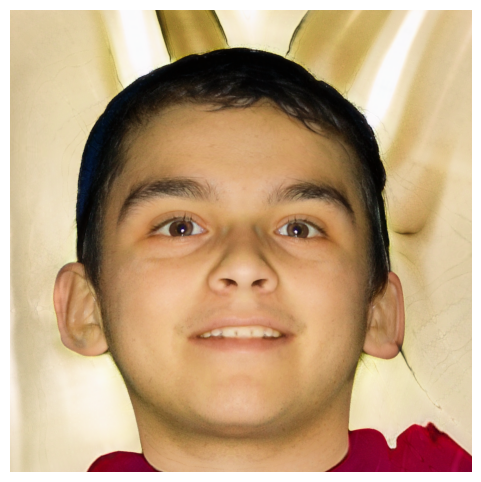

In [8]:
image = Image.open('/content/results/seed%04d.png' % seed)
plt.figure(figsize = (6,6))
plt.axis('off')
plt.imshow(image)

In [9]:
!python gen_images.py --network={url} --outdir=/content/results --seeds=200-210

Loading networks from "https://api.ngc.nvidia.com/v2/models/nvidia/research/stylegan3/versions/1/files/stylegan3-r-ffhq-1024x1024.pkl"...
Generating image for seed 200 (0/11) ...
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.
Generating image for seed 201 (1/11) ...
Generating image for seed 202 (2/11) ...
Generating image for seed 203 (3/11) ...
Generating image for seed 204 (4/11) ...
Generating image for seed 205 (5/11) ...
Generating image for seed 206 (6/11) ...
Generating image for seed 207 (7/11) ...
Generating image for seed 208 (8/11) ...
Generating image for seed 209 (9/11) ...
Generating image for seed 210 (10/11) ...


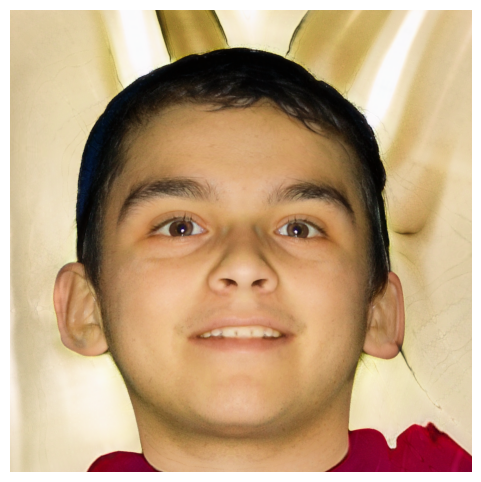

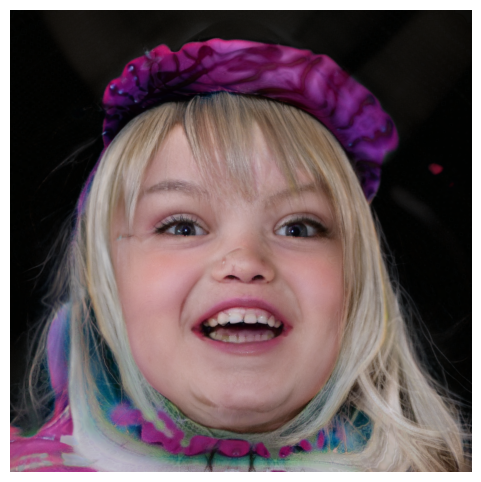

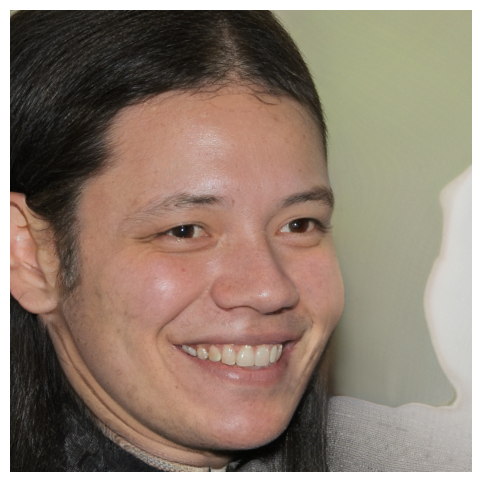

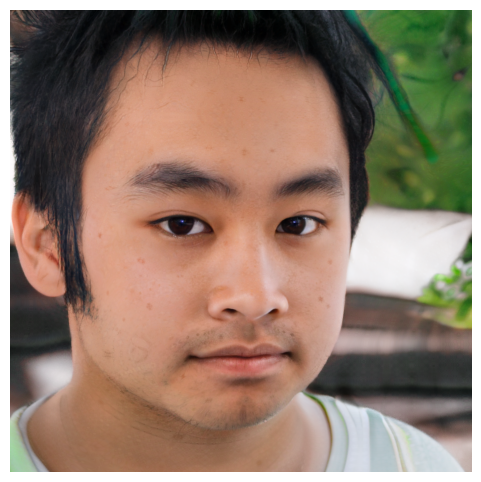

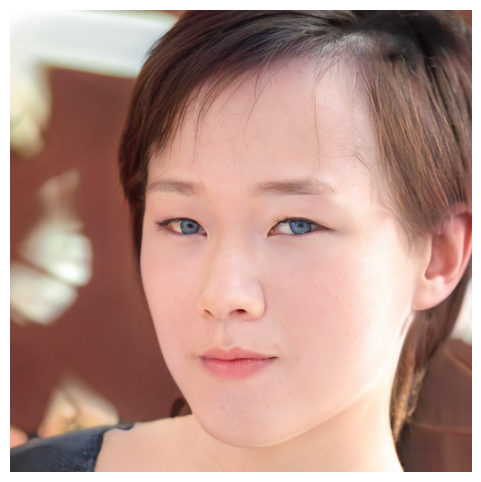

...

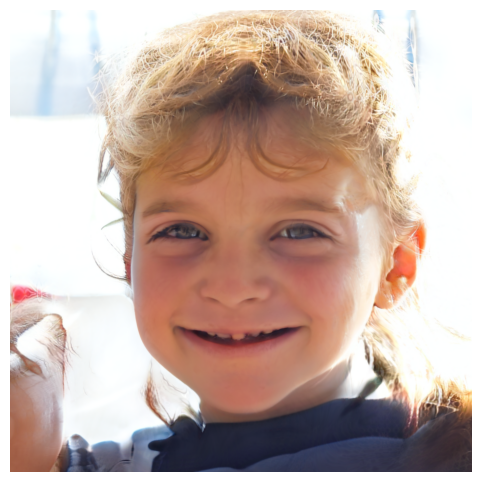

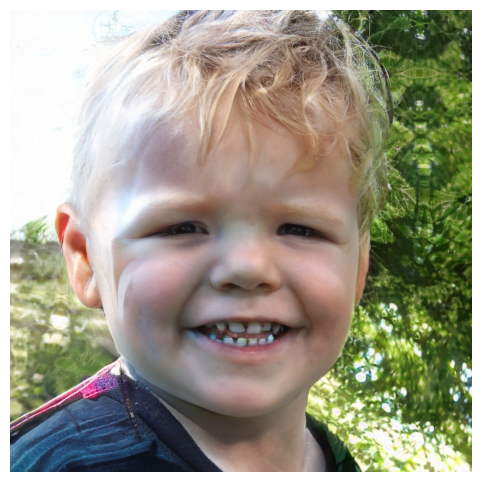

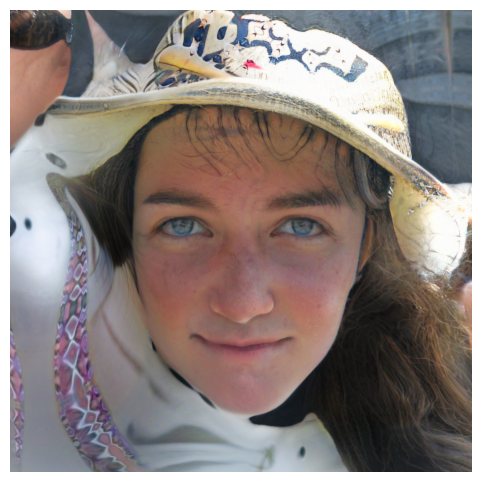

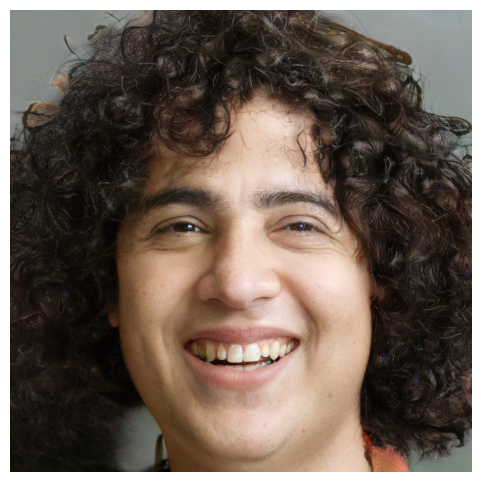

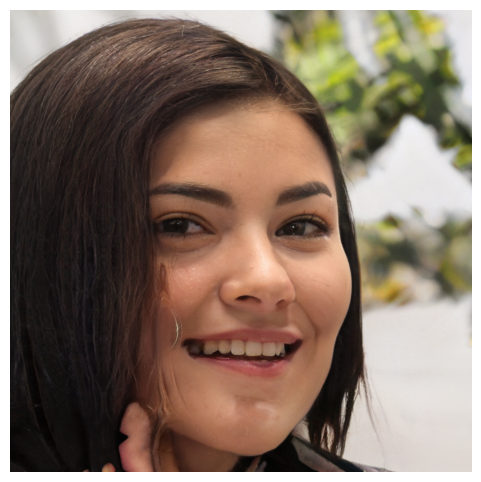

In [10]:
seed_start = 200
seed_end = 210

for n_seed in range(seed_start, seed_end + 1):
  #print(n_seed)
  image = Image.open('/content/results/seed%04d.png' % n_seed)
  plt.figure(figsize = (6,6))
  plt.axis('off')
  plt.imshow(image)

## Functions to generate images

In [11]:
device = torch.device('cuda')
def load_network(url, device):
  with dnnlib.util.open_url(url) as f:
    G = legacy.load_network_pkl(f)['G_ema'].to(device)
  return G

In [12]:
G = load_network(url, device)

> **z** Noise Vector (latent)

More about z and other important StyleGAN concepts -> https://towardsdatascience.com/analyzing-how-stylegan-works-style-incorporation-in-high-quality-image-generation-80a29227075b

In [13]:
def generate_z(G, seed):
  return np.random.RandomState(seed).randn(1, G.z_dim)

In [14]:
seed = np.random.randint(80000000)
print(seed)
z = generate_z(G, seed)
print(z.shape)

29485852
(1, 512)


> **Truncation**

- The lower the value, the lower the diversity. The higher the value, the greater the diversity
- Paper truncation: https://paperswithcode.com/method/truncation-trick
- Paper noise: https://nvlabs-fi-cdn.nvidia.com/stylegan3/stylegan3-paper.pdf

In [15]:
def generate_image(device, G, z, truncation_psi=1.0, noise_mode='const', class_idx=None):
  z = torch.from_numpy(z).to(device)
  label = torch.zeros([1, G.c_dim], device=device)
  img = G(z, label, truncation_psi=truncation_psi, noise_mode=noise_mode)
  # (1, 3, 1024, 1024) -> (1024, 1024, 3)
  img = (img.permute(0,2,3,1) * 127.5 + 128).clamp(0, 255).to(torch.uint8)
  return Image.fromarray(img[0].cpu().numpy(), 'RGB')

In [16]:
def show_img(image):
  plt.axis('off')
  plt.imshow(image)
  plt.show()

## Generate images and display the results

Seed: 7000
Setting up PyTorch plugin "bias_act_plugin"... Done.
Setting up PyTorch plugin "filtered_lrelu_plugin"... Done.


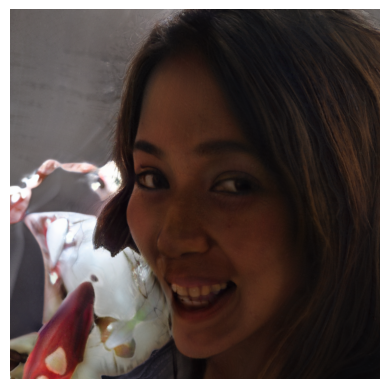

In [17]:
seed = 7000
print('Seed:', seed)
z = generate_z(G, seed)
img = generate_image(device, G, z)
show_img(img)

Seed:  7210


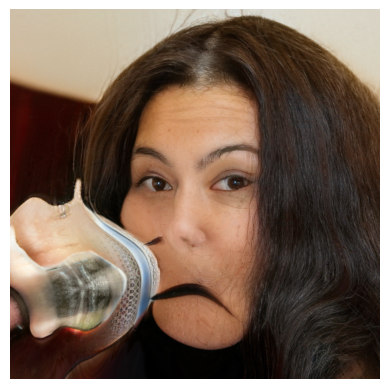

Seed:  7262


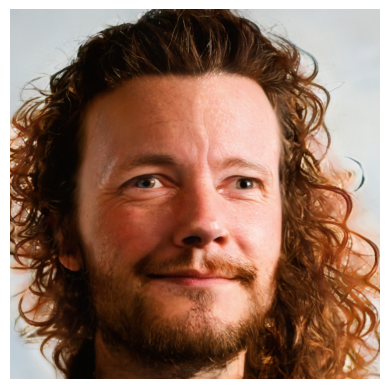

Seed:  7295


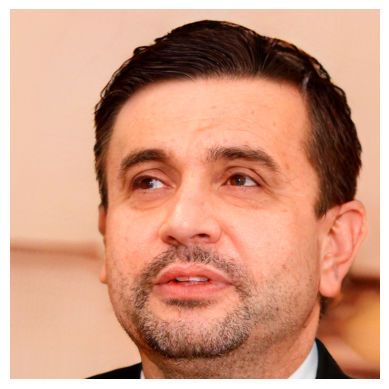

Seed:  7218


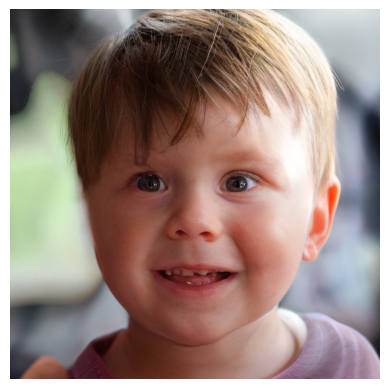

Seed:  700


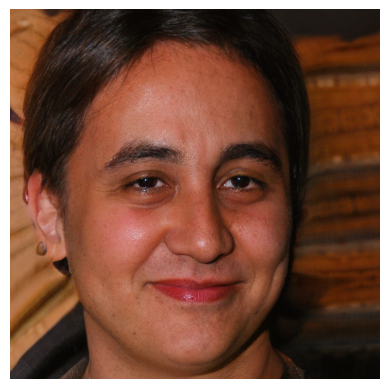

Seed:  350


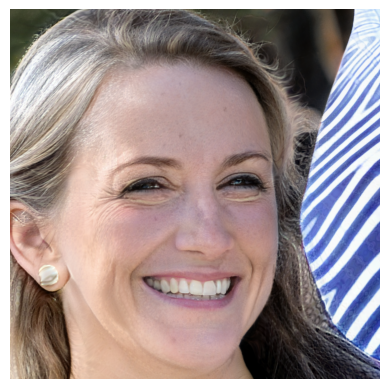

In [18]:
seed_list = [7210, 7262, 7295, 7218, 700, 350]

for s in seed_list:
  print('Seed: ', s)
  z = generate_z(G, s)
  img = generate_image(device, G, z)
  show_img(img)

## Truncation

Seed:  7000


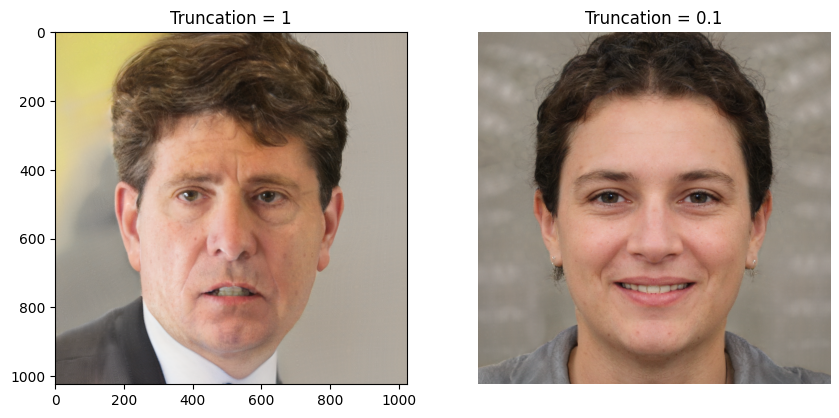

Seed:  7000


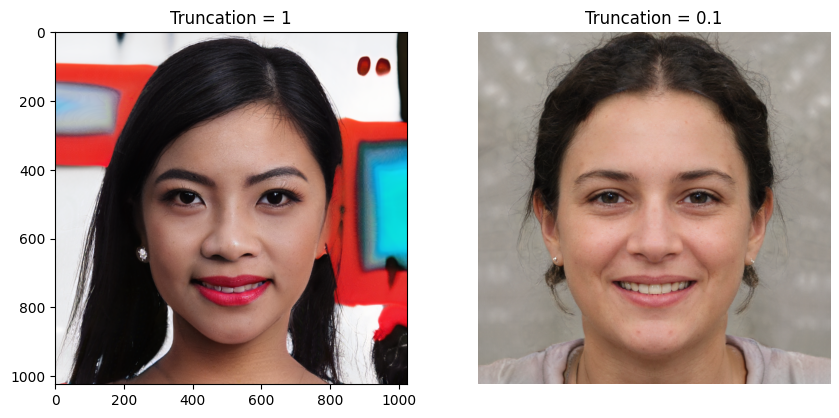

Seed:  7000


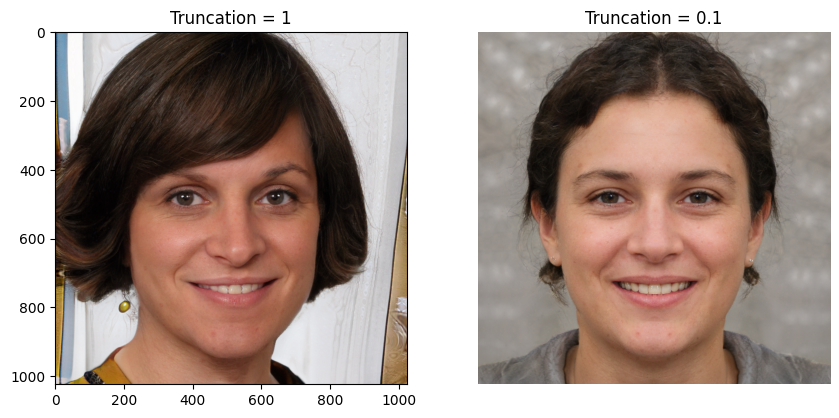

Seed:  7000


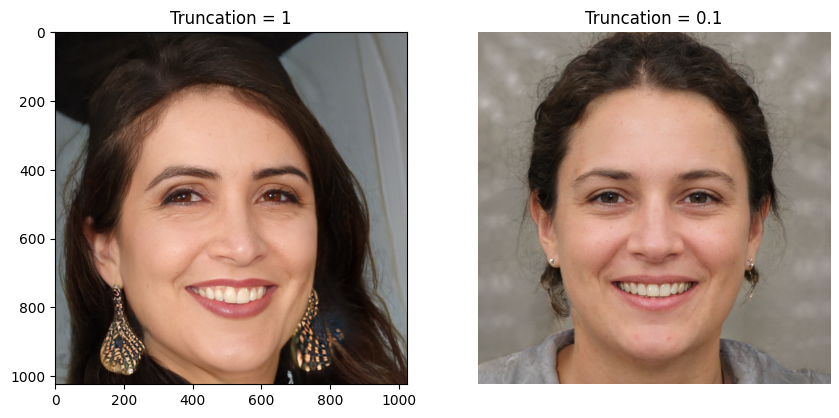

Seed:  7000


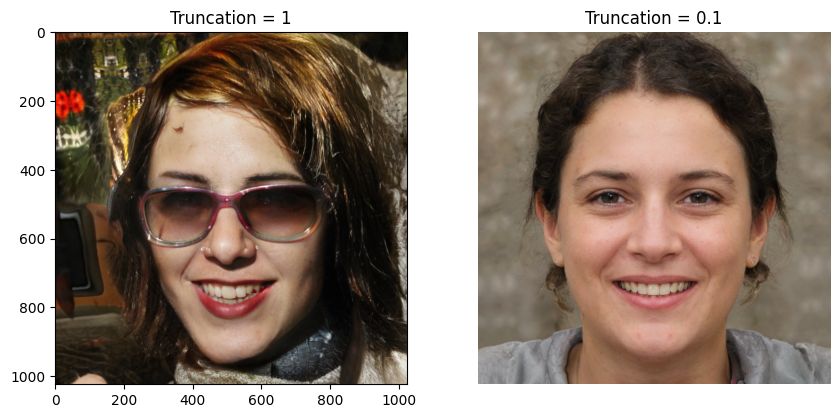

Seed:  7000


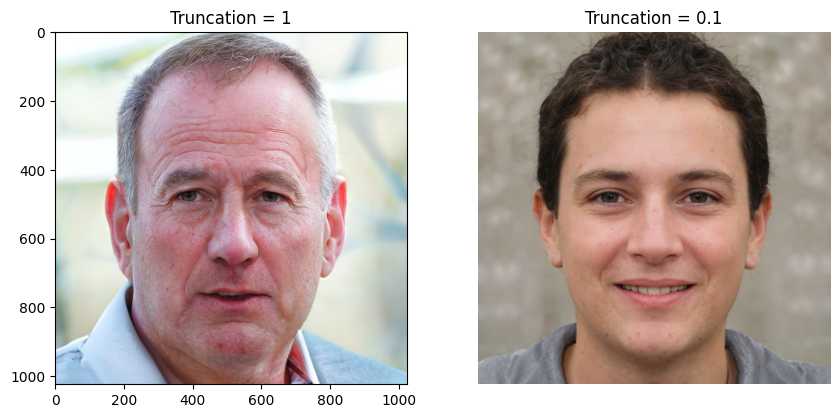

Seed:  7000


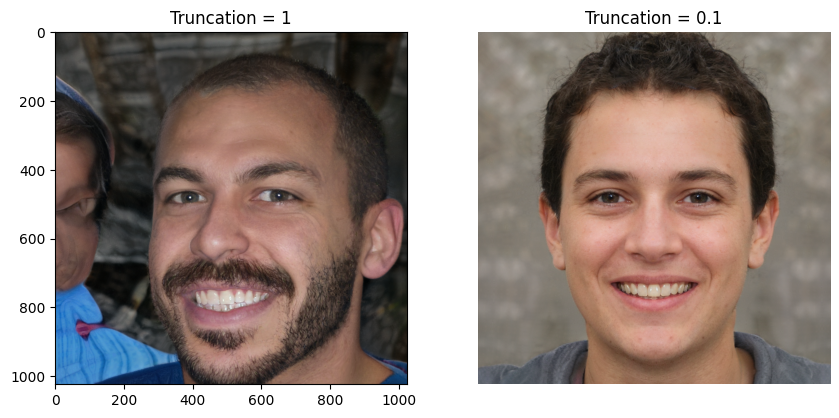

In [19]:
seed_start = 7710
seed_end = 7716
custom_truncation = 0.1

for s in range(seed_start, seed_end+1):
  plt.figure(figsize=(10,6))
  print('Seed: ', seed)
  z = generate_z(G, s)

  image = generate_image(device, G, z)
  image2 = generate_image(device, G, z, custom_truncation)
  plt.subplot(1,2,1)
  plt.title('Truncation = 1')
  plt.imshow(image)

  plt.subplot(1,2,2)
  plt.title('Truncation = {}'.format(custom_truncation))
  plt.imshow(image2)

  plt.axis('off')
  plt.show()

## Interpolation

Change from one person to another, and see the whole transition (steps). To do that, a **Latent vector** is needed

> Visualization of the latent space https://hackernoon.com/latent-space-visualization-deep-learning-bits-2-bd09a46920df


In [20]:
from tqdm.notebook import tqdm as log_progress

In [21]:
os.makedirs('/content/interpolation/', exist_ok = True)

In [22]:
seeds = [7710, 7762]
num_vectors = 10

def interpolation(seeds, num_vectors, truncation = 1):
  interpolation_images = []

  idx = 0
  for i in range(len(seeds) - 1):
    latent1 = generate_z(G, seeds[i])
    latent2 = generate_z(G, seeds[i + 1])

    difference = latent2 - latent1
    step = difference / num_vectors
    current = latent1.copy()

    for j in log_progress(range(num_vectors), desc=f'Seed {seeds[i]}'):
      current = current + step
      image = generate_image(device, G, current, truncation)
      interpolation_images.append(image)
      image.save(f'/content/interpolation/frame-{idx}.png')
      idx += 1
  return interpolation_images

In [23]:
interpolation_images = interpolation(seeds, num_vectors, 0.7)

Seed 7710:   0%|          | 0/10 [00:00<?, ?it/s]

In [24]:
from math import ceil
from google.colab.patches import cv2_imshow

def show_images_grid(images, scale=0.25, lines=1):
   w, h = images[0].size
   w = int(w*scale)
   h = int(h*scale)
   height = lines*h
   cols = ceil(len(images) / lines)
   width = cols*w
   grid = Image.new('RGBA', (width,height), 'white')
   for i, img in enumerate(images):
     img = img.resize((w,h), Image.ANTIALIAS)
     grid.paste(img, (w*(i % cols), h*(i // cols)))

   grid = np.array(grid)
   return grid

def show_full_image(image):
  image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
  return cv2_imshow(image)

<ipython-input-24-f6c0a8a69849>:13: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  img = img.resize((w,h), Image.ANTIALIAS)


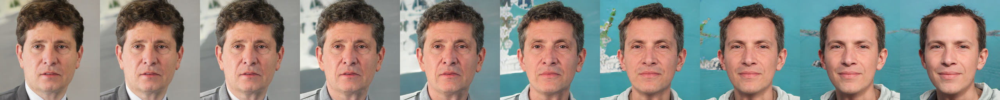

In [25]:
grid_images = show_images_grid(interpolation_images)
show_full_image(grid_images)

## Creating a gif

In [26]:
import imageio
from IPython.display import Image as displayImage

def create_gif(output_file, images_interpolation):
  with imageio.get_writer(output_file, mode='I', duration=0.15) as writer:

    for i, image in enumerate(images_interpolation):
      frame_anim = np.array(image)
      frame_anim = cv2.resize(frame_anim, (300,300))
      writer.append_data(frame_anim)

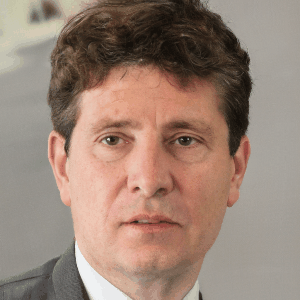

In [27]:
output_file = 'animination.gif'
create_gif(output_file, interpolation_images)
displayImage(open(output_file, 'rb').read())

## Testing other pretrained models

> https://github.com/NVlabs/metfaces-dataset - image dataset of human faces extracted from works of art

Seed: 5010


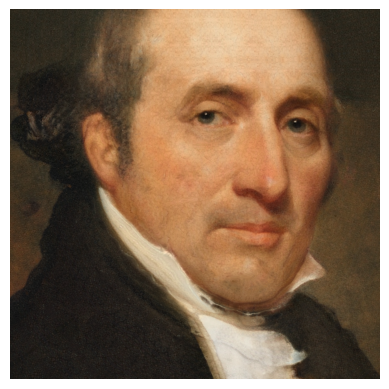

Seed: 5011


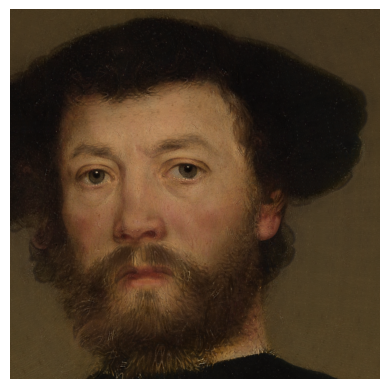

Seed: 5012


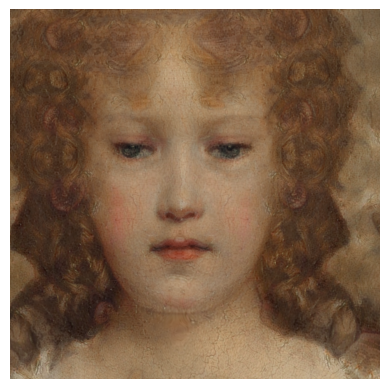

Seed: 5013


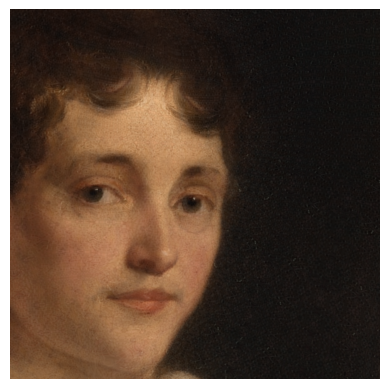

Seed: 5014


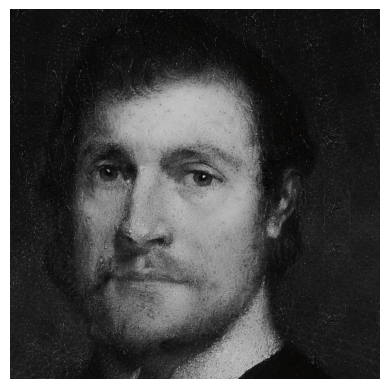

Seed: 5015


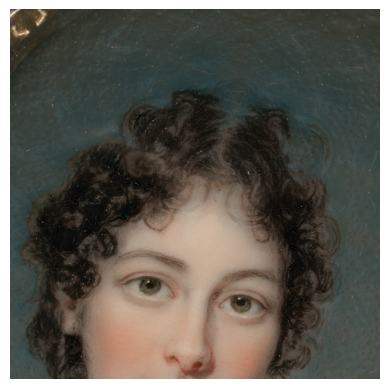

Seed: 5016


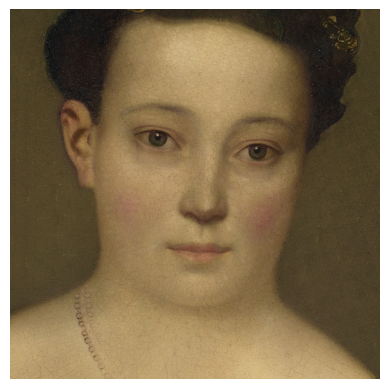

Seed: 5017


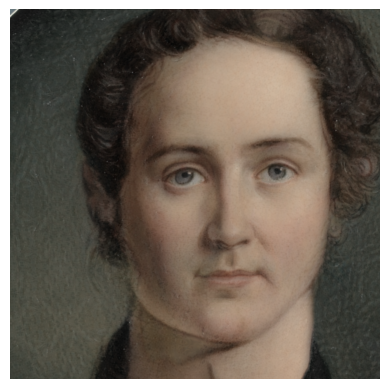

Seed: 5018


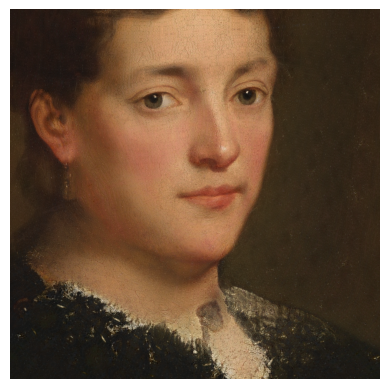

Seed: 5019


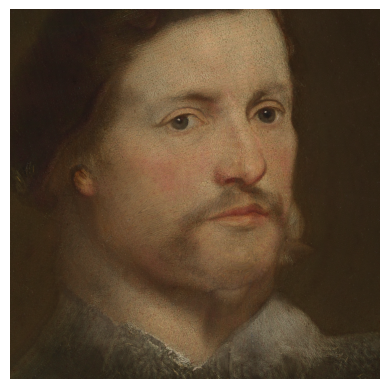

Seed: 5020


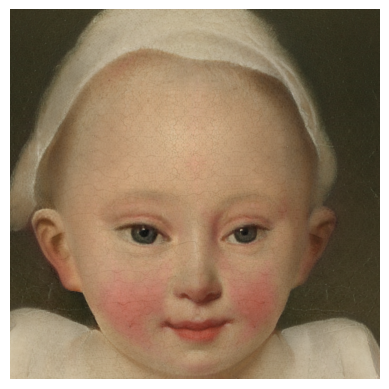

In [28]:
model = 'stylegan3-r-metfacesu-1024x1024.pkl'
url = base_url + model

seed_start = 5010
seed_end = 5020

G = load_network(url, device)

for s in range(seed_start, seed_end+1):
  print(f"Seed: {s}")
  z = generate_z(G, s)
  img = generate_image(device, G, z, 0.7)
  show_img(img)

Seed 8015:   0%|          | 0/10 [00:00<?, ?it/s]

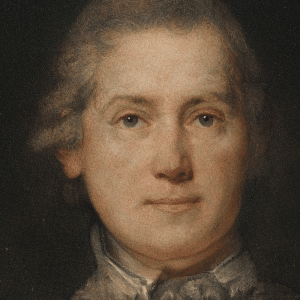

In [29]:
seeds = [8015, 8010]
num_vectors = 10

interpolation_images = interpolation(seeds, num_vectors, 0.5)

output_file = 'animation_metfaces.gif'
create_gif(output_file, interpolation_images)
displayImage(open(output_file,'rb').read())

> [Animal FacesHQ (AFHQ)](https://paperswithcode.com/dataset/afhq) - dataset of animal faces consisting of 15,000 high-quality images at 512 × 512 resolution. The dataset includes three domains of cat, dog, and wildlife, each providing 5000 images

Seed: 7210


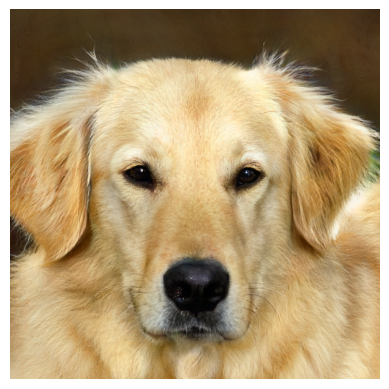

Seed: 7211


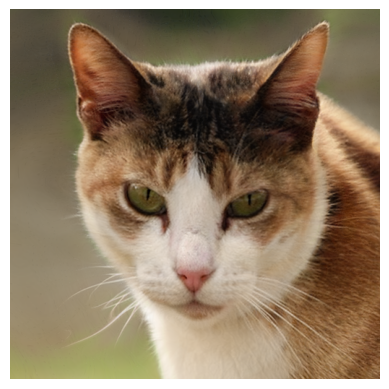

Seed: 7212


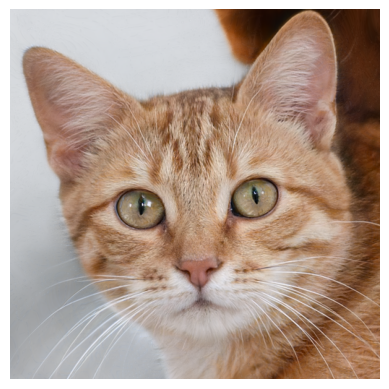

Seed: 7213


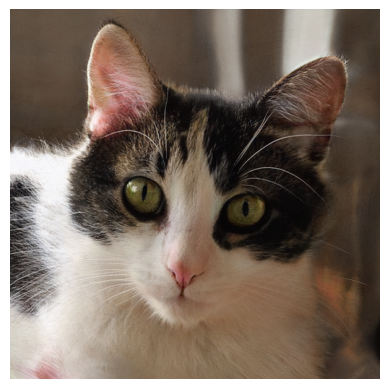

Seed: 7214


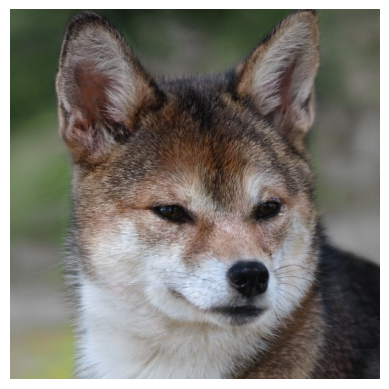

Seed: 7215


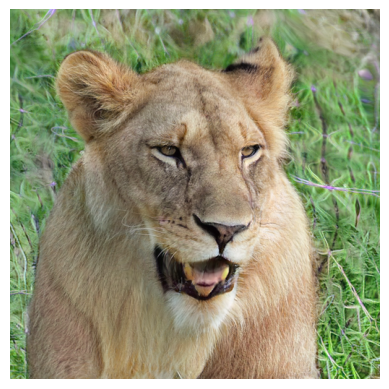

Seed: 7216


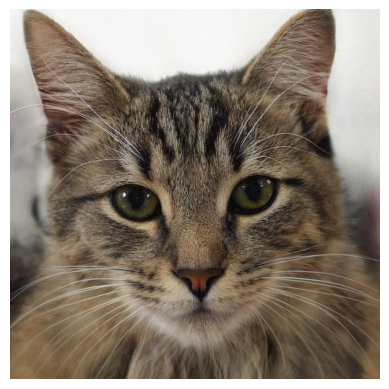

Seed: 7217


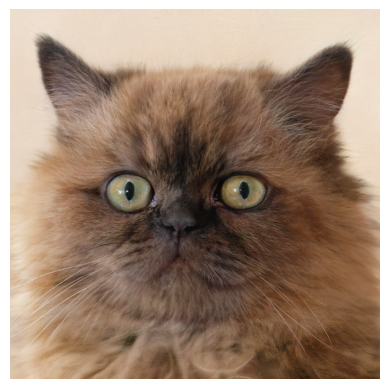

Seed: 7218


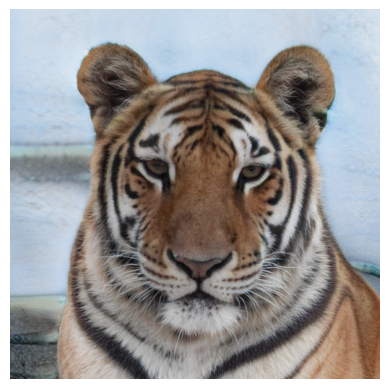

Seed: 7219


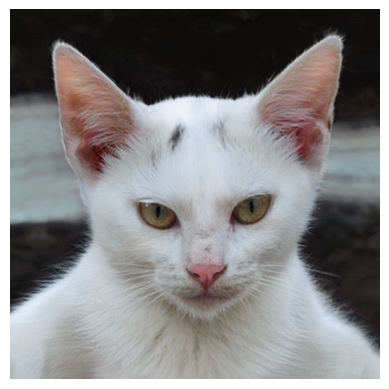

Seed: 7220


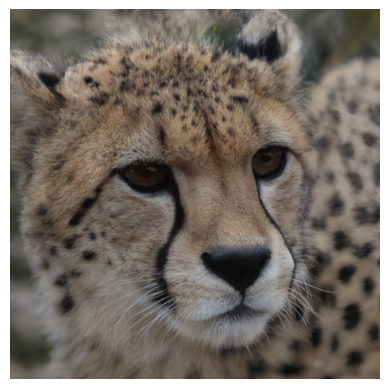

In [30]:
model = 'stylegan3-t-afhqv2-512x512.pkl'
url = base_url + model

seed_start = 7210
seed_end = 7220

G = load_network(url, device)

for s in range(seed_start, seed_end+1):
  print(f"Seed: {s}")
  z = generate_z(G, s)
  img = generate_image(device, G, z, 0.7)
  show_img(img)

Seed 3220:   0%|          | 0/20 [00:00<?, ?it/s]

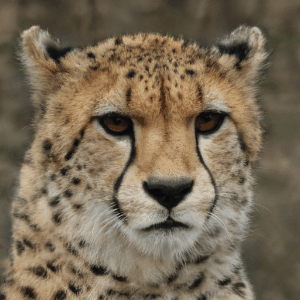

In [31]:
seeds = [3220, 3211]
num_vectors = 20

interpolation_images = interpolation(seeds, num_vectors, 0.5)

output_file = 'animation_afhqv2.gif'
create_gif(output_file, interpolation_images)
displayImage(open(output_file,'rb').read())